In [2]:
path_to_data = '../data/raw/'


About the Dataset

    The dataset is popularly known as Smartphone Image Denoising Dataset (SIDD).
    It contains 160 pairs of noisy/ground-truth images.
    The images are of exceptionally high-quality and have been taken by different smartphones under different illuminations.

Complete readme is as printed below.


In [3]:
with open(path_to_data + 'SIDD_Small_sRGB_Only/_ReadMe.txt') as f:
    readme = f.read()
    
print(readme)

*** This is a small version of the Smartphone Image Denoising Dataset (SIDD)

The "Data" directory contains 160 images representing 160 scene instances. These images can be used for training/learning purposes.

For each image, the following is provided in one directory:

1 - Noisy Raw-RGB image (.MAT).
Black Level subtracted, normalized to [0, 1].

2 - Ground truth Raw-RGB image (.MAT).
Black Level subtracted, normalized to [0, 1].

3 - Noisy sRGB image (.PNG).
Gamma corrected, without any tone mapping.

4 - Ground truth sRGB image (.PNG), gamma corrected, without any tone mapping.
Gamma corrected, without any tone mapping.

5 - Metadata extracted from the DNG file (.MAT).
For example, black and saturation levels, as-shot neutral, noise level function, etc.

So, the total number of files in the "Data" directory is 160 x 5 = 800.


*** Image directory naming convention:

Each image is stored in a directory with the name of the scene instance as follows:

<scene-instance-number>_<scene_n

In [4]:
with open(path_to_data + 'SIDD_Small_sRGB_Only/Scene_Instances.txt') as f:
    instances = f.read()
    
instances = instances.split('\n')
instances[:5]


['0001_001_S6_00100_00060_3200_L',
 '0002_001_S6_00100_00020_3200_N',
 '0003_001_S6_00100_00060_3200_H',
 '0004_001_S6_00100_00060_4400_L',
 '0005_001_S6_00100_00060_4400_N']

In [5]:
path = path_to_data + 'SIDD_Small_sRGB_Only/Data/'

noisy_images_path = []
gt_images_path = []

for f in instances:
    images_path = path + f + '/'
    
    for g in os.listdir(images_path):
        image_path = images_path + g
        
        if 'NOISY' in image_path:
            noisy_images_path.append(image_path)
        else:
            gt_images_path.append(image_path)
            

print('TOTAL NOISY IMAGES:', len(noisy_images_path))
print('TOTAL GROUND TRUTH IMAGES:', len(gt_images_path))

TOTAL NOISY IMAGES: 160
TOTAL GROUND TRUTH IMAGES: 160


In [7]:
!pip install opencv-python

In [9]:
from tqdm import tqdm
import cv2

HEIGHT = [] 
WIDTH = []

for f in tqdm(noisy_images_path):
    img = cv2.imread(f)
    height, width, channels = img.shape
    
    HEIGHT.append(height)
    WIDTH.append(width)
    
print('MIN HEIGHT:', min(HEIGHT))
print('MAX HEIGHT:', max(HEIGHT))
print()
print('MIN WIDTH:', min(WIDTH))
print('MAX WIDTH:', max(WIDTH))

100%|██████████| 160/160 [00:45<00:00,  3.55it/s]

MIN HEIGHT: 2988
MAX HEIGHT: 3120

MIN WIDTH: 4032
MAX WIDTH: 5328


Reduce the size of images and pack them in numpy arrays for faster processing in our tasks

In [10]:
## https://www.kaggle.com/datasets/rajat95gupta/smartphone-image-denoising-dataset/

IMG_SIZE = 1024
size = (IMG_SIZE, IMG_SIZE)

noisy_img_array = []

for f in tqdm(noisy_images_path):
    img = cv2.imread(f)
    img = cv2.resize(img, size)
    
    noisy_img_array.append(img)
    
gt_img_array = []

for f in tqdm(gt_images_path):
    img = cv2.imread(f)
    img = cv2.resize(img, size)
    
    gt_img_array.append(img)


100%|██████████| 160/160 [00:41<00:00,  3.84it/s]


In [11]:
import numpy as np

noisy_img_array = np.array(noisy_img_array)
gt_img_array = np.array(gt_img_array)

print('NOISY IMG ARRAY:', noisy_img_array.shape)
print('GT IMG ARRAY:', gt_img_array.shape)

NOISY IMG ARRAY: (160, 1024, 1024, 3)
GT IMG ARRAY: (160, 1024, 1024, 3)



## Visualizing Images

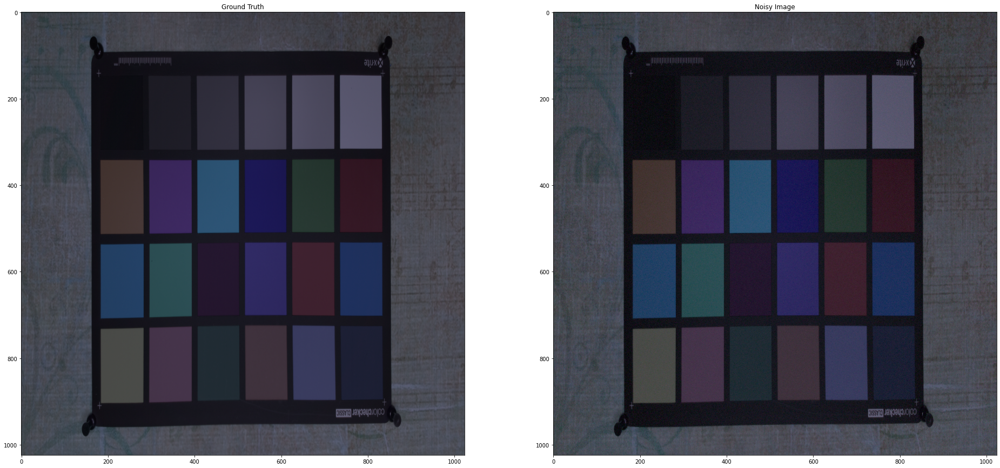

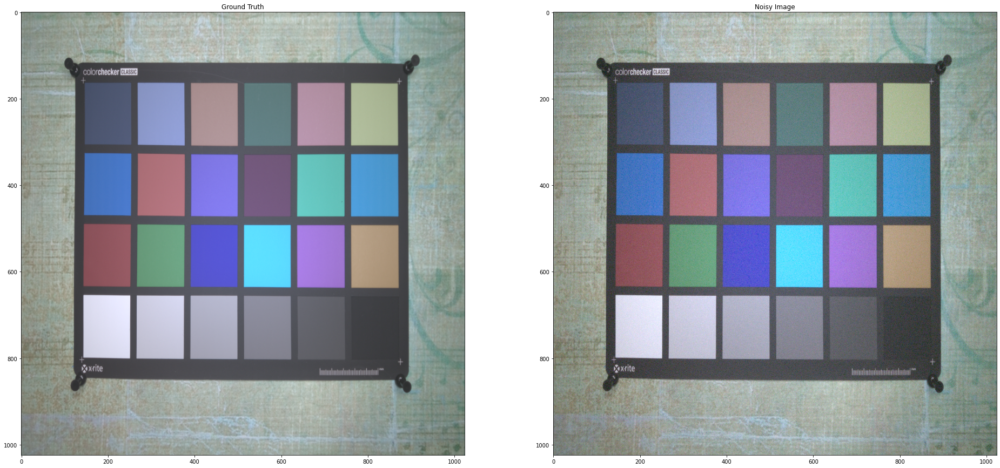

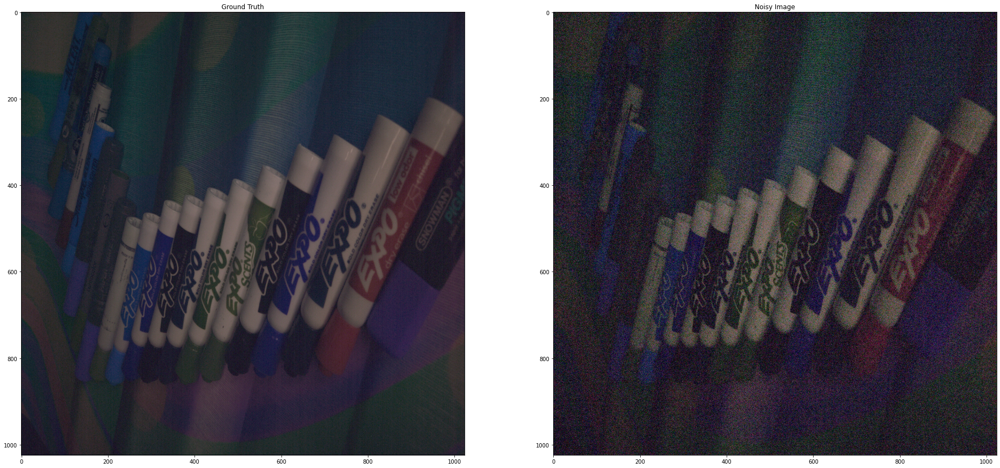

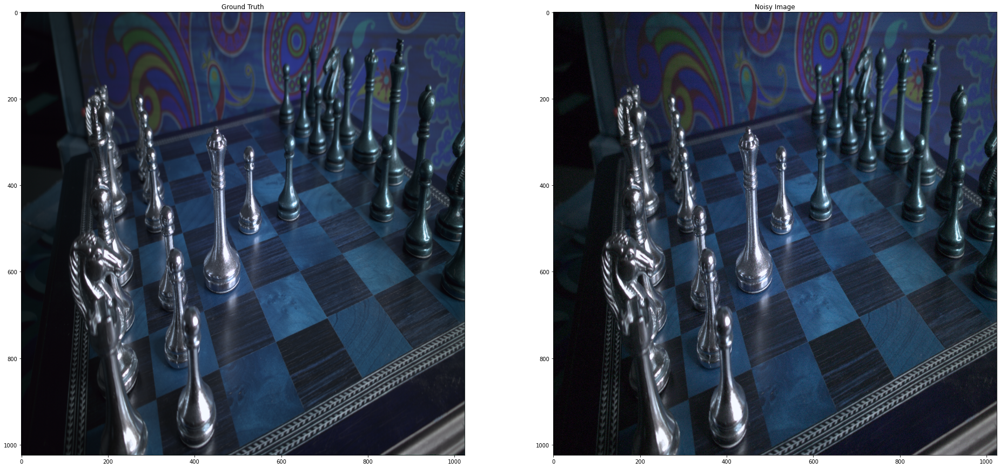

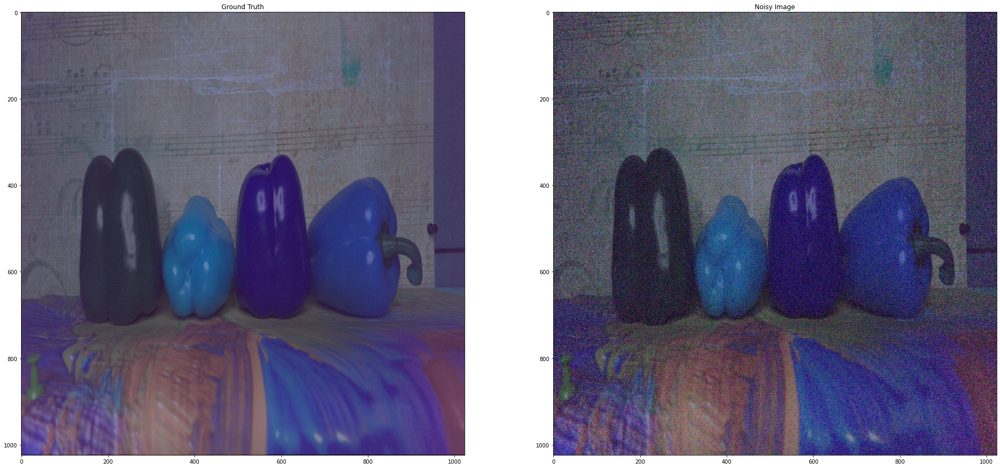

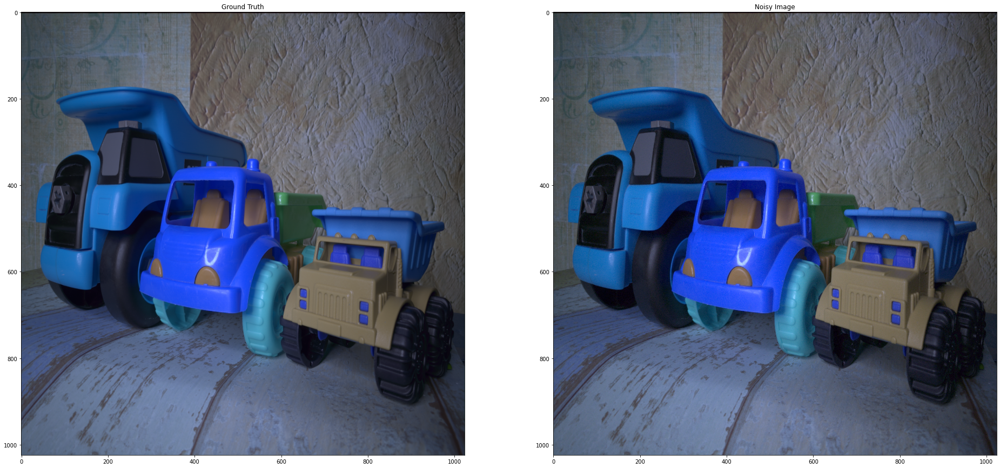

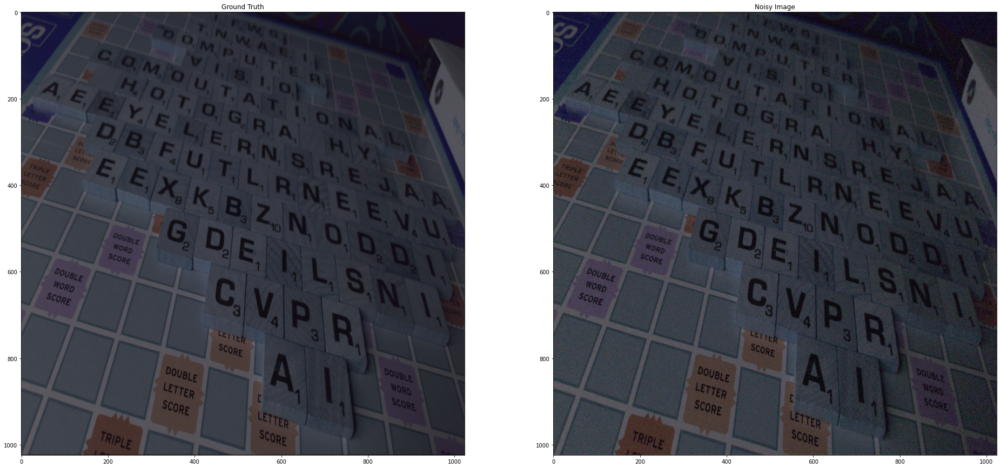

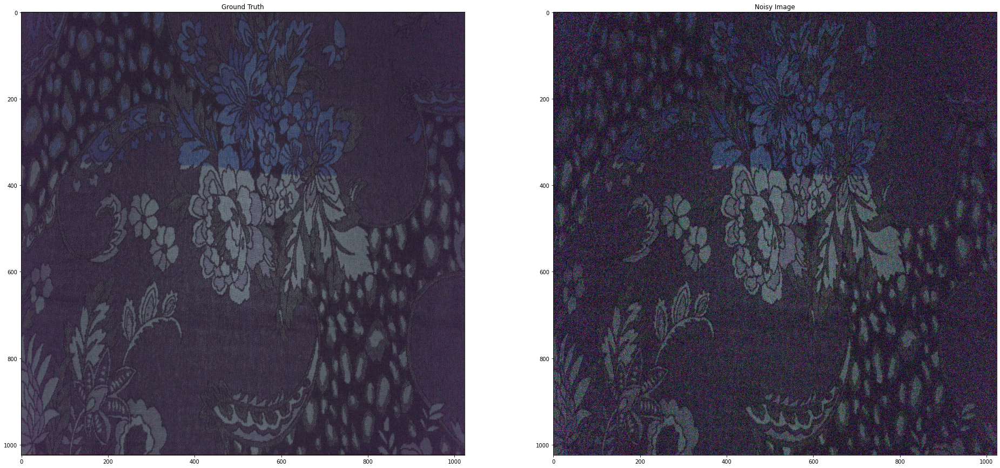

In [16]:
import matplotlib.pyplot as plt

for i in range(0,len(noisy_img_array),20):
    
    fig=plt.figure(figsize=(50, 25))
    
    ax = plt.subplot(131)
    plt.title('Ground Truth')
    plt.imshow(gt_img_array[i])
    
    ax = plt.subplot(132)
    plt.title('Noisy Image')
    plt.imshow(noisy_img_array[i])
    plt.show()


## Saving Data

In [18]:
np.save('../data/interim/noisy_img_array.npy', noisy_img_array)
np.save('../data/interim/gt_img_array.npy', gt_img_array)

In [ ]:
# To load the arrays

# noisy_img_array = np.load('noisy_img_array.npy', allow_pickle=True)
# gt_img_array = np.load('gt_img_array.npy', allow_pickle=True)